# Predicting Free Throw Success and Defining Good Form: Analyzing Temporal and Biomechanical Patterns

This project aims to develop a predictive model for free throw success using biomechanics data collected by Maple Leafs Sports \& Entertainment's (MLSE) Sport Performance Lab (SPL). The dataset comprises raw, markerless motion capture data from 125 free throw attempts by a professional basketball player, providing a unique opportunity to analyze the biomechanical and temporal factors that contribute to successful shots. By identifying these patterns, this project seeks to offer actionable insights for players and coaches, potentially aiding in the refinement of shooting techniques and training programs. Biomechanical factors such as joint angles, body alignment, and coordinated movement patterns are known to be critical for free throw success, yet they are often studied in isolation. This analysis combines multiple biomechanical variables into a cohesive model, revealing how complex, whole-body movement patterns influence shot success. To achieve this, a recurrent neural network (RNN) is incorporated to capture temporal dependencies across sequences of movement. This approach leverages the high-quality temporal data provided by MLSE, addressing a gap in current research by applying advanced modeling techniques for improved predictive accuracy. Ultimately, this analysis aims to advance understanding of the biomechanics behind successful free throws and enhance data-driven decision-making in sports.

# Setup

In [2]:
!pip install mplbasketball
!pip install torch-geometric
!pip install pillow

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 63.1/63.1 kB 1.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 15.1 MB/s eta 0:00:00


In [56]:
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torchvision
from torch.utils.data.sampler import SubsetRandomSampler
import matplotlib.pyplot as plt
from torchvision import datasets, transforms
from torch.utils.data import DataLoader, TensorDataset, Dataset, Subset
import random
from torchvision.datasets import ImageFolder
import json
import pandas as pd
import os
from sklearn.model_selection import train_test_split
from torch.nn.utils.rnn import pad_sequence, pack_padded_sequence, pad_packed_sequence
from matplotlib import cm

Mount google drive and make sure to have uploaded the SPL-Open-Data folder to your drive.

In [4]:
from google.colab import drive

# Mount Google Drive
drive.mount('/content/drive')

Mounted at /content/drive


# Loading the Data

In [5]:
def get_num_trials(participant_id):
  participant_id = f"{participant_id:04}"
  # Get folder path for given participant_id
  dir_path = f'/content/drive/MyDrive/SPL-Open-Data/basketball/freethrow/data/P{participant_id}'
  num_trials = 0
  # Count number of files in the folder
  for path in os.listdir(dir_path):
    num_trials += 1
  return num_trials

In [6]:
def open_json(path):

  with open(path) as file:
    data = json.load(file)
    return data

In [7]:
def load_data(participant_id):
  all_data = []
  num_trials = get_num_trials(participant_id)
  participant_id = f"{participant_id:04}"
  for trial_num in range(num_trials):
    trial_id = f"{(trial_num + 1):04}"
    path = f'/content/drive/MyDrive/SPL-Open-Data/basketball/freethrow/data/P{participant_id}/BB_FT_P{participant_id}_T{trial_id}.json'
    data = open_json(path)
    all_data.append(data)
  return all_data

In [8]:
all_data = load_data(1)

| Keypoint number | Keypoint name | Description
| :-: | :-: | :-:
| 1 | R_EYE | Right eye
| 2 | L_EYE | Left eye
| 3 | NOSE | Nose
| 4 | R_EAR | Right ear
| 5 | L_EAR | Left ear
| 6 | R_SHOULDER | Right shoulder
| 7 | L_SHOULDER | Left shoulder
| 8 | R_ELBOW | Right elbow
| 9 | L_ELBOW | Left elbow
| 10 | R_WRIST | Right wrist
| 11 | L_WRIST | Left wrist
| 12 | R_1STFINGER | Right thumb base joint
| 13 | R_5THFINGER | Right pinky base joint
| 14 | L_5THFINGER | Left pinky base joint
| 15 | L_1STFINGER | Left thumb base joint
| 16 | R_HIP | Right hip
| 17 | L_HIP | Left hip
| 18 | R_KNEE | Right knee
| 19 | L_KNEE | Left knee
| 20 | R_ANKLE | Right ankle
| 21 | R_5THTOE | Right small toe
| 22 | R_1STTOE | Right big toe
| 23 | R_CALC | Right calcaneus (heel)
| 24 | L_ANKLE | Left ankle
| 25 | L_1STTOE | Left big toe
| 26 | L_5THTOE | Left small toe
| 27 | L_CALC | Left calcaneus (heel)

In [9]:
ground_truth = []
for data in range(len(all_data)):
  if all_data[data]['result'] == 'missed':
    ground_truth.append(0)
  else:
    ground_truth.append(1)
print(ground_truth)

[0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1]


# Preprocessing the Data + Feature Engineering

The model utilizes biomechanical features manually derived from key body parts in each frame, focusing on distances, angles, and symmetry measurements that capture the player’s form and movement patterns during the free throw sequence. This results  in a temporal dataset that captures both static and dynamic biomechanical characteristics of the free throw attempt. By combining these biomechanical measurements, the model gains a comprehensive representation of the player’s form and movement patterns, enabling the analysis of key factors that contribute to successful free throw shots.

In [10]:
def calculate_distance(point1, point2):
    return np.linalg.norm(np.array(point1) - np.array(point2))

def calculate_angle(p1, p2, p3):
    # Angle p1p2p3
    a = np.array(p1) - np.array(p2)
    b = np.array(p3) - np.array(p2)
    cosine_angle = np.dot(a, b) / (np.linalg.norm(a) * np.linalg.norm(b))
    angle = np.arccos(np.clip(cosine_angle, -1.0, 1.0))
    return np.degrees(angle)

def extract_features_from_frame(frame_data):
    features = []

    # Example distances
    features.append(calculate_distance(frame_data['R_SHOULDER'], frame_data['R_WRIST']))  # Right arm extension
    features.append(calculate_distance(frame_data['L_SHOULDER'], frame_data['L_WRIST']))  # Left arm extension
    features.append(calculate_distance(frame_data['R_HIP'], frame_data['R_ANKLE']))       # Right knee bend
    features.append(calculate_distance(frame_data['L_HIP'], frame_data['L_ANKLE']))       # Left knee bend

    # Example angles
    features.append(calculate_angle(frame_data['R_SHOULDER'], frame_data['R_ELBOW'], frame_data['R_WRIST']))  # Right elbow angle
    features.append(calculate_angle(frame_data['L_SHOULDER'], frame_data['L_ELBOW'], frame_data['L_WRIST']))  # Left elbow angle
    features.append(calculate_angle(frame_data['R_HIP'], frame_data['R_KNEE'], frame_data['R_ANKLE']))        # Right knee angle
    features.append(calculate_angle(frame_data['L_HIP'], frame_data['L_KNEE'], frame_data['L_ANKLE']))        # Left knee angle

    # Body symmetry (example: shoulder height difference)
    features.append(abs(frame_data['R_SHOULDER'][1] - frame_data['L_SHOULDER'][1]))  # Y-coordinate difference for shoulders

    return features


In [11]:
def is_valid_frame(frame):
    # Check if any ball data is NaN
    if any(np.isnan(frame['data']['ball'])):
        return False

    # Check if any player data has NaN values
    for key, value in frame['data']['player'].items():
        if any(np.isnan(value)):
            return False

    return True

In [13]:
data_with_valid_frames = []
for data in range(len(all_data)):
  trial_data = all_data[data]
  valid_frames = [frame for frame in trial_data['tracking'] if is_valid_frame(frame)]
  data_with_valid_frames.append(valid_frames)

In [14]:
all_sequences = []

for free_throw_sequence in data_with_valid_frames:  # Each free throw sequence contains multiple frames (timesteps)
    sequence_features = []

    for frame_data in free_throw_sequence:
        # Use is_valid_frame to check the data quality
        if is_valid_frame(frame_data):
            # Extract features if the frame is valid
            features = extract_features_from_frame(frame_data['data']['player'])
            sequence_features.append(features)

    # Only add sequence if it has sufficient valid frames
    if len(sequence_features) > 0:  # Optionally set a minimum threshold for valid frames
        all_sequences.append(sequence_features)

In [15]:
all_sequences = [torch.tensor(seq, dtype=torch.float32) for seq in all_sequences]

# Pad sequences to uniform length
# This will create a tensor of shape [num_sequences, max_sequence_length, feature_dim]
padded_sequences = pad_sequence(all_sequences, batch_first=True, padding_value=0.0)

# Visualizing the Input to the Model

In [16]:
from matplotlib.animation import FuncAnimation

# Connections are the distance and angle features engineered into the model
connections = [
    ("R_SHOULDER", "R_WRIST"),
    ("L_SHOULDER", "L_WRIST"),
    ("R_HIP", "R_ANKLE"),
    ("L_HIP", "L_ANKLE"),
    ("R_SHOULDER", "L_SHOULDER"),
    ("R_SHOULDER", "R_ELBOW"),
    ("R_ELBOW", "R_WRIST"),
    ("L_SHOULDER", "L_ELBOW"),
    ("L_ELBOW", "L_WRIST"),
    ("R_HIP", "R_ANKLE"),
    ("R_HIP", "R_KNEE"),
    ("R_KNEE", "R_ANKLE"),
    ("L_HIP", "L_KNEE"),
    ("L_KNEE", "L_ANKLE")
]


In [17]:
def animate_trial(
    path_to_json,
    connections=connections,
    xbuffer=4.0,
    ybuffer=4.0,
    zlim=8.0,
    elev=15.0,
    azim=40.0,
    player_color="purple",
    player_lw=2,
    ball_color="#ee6730",
    ball_size=20.0,
    show_court=True,
    notebook_mode=True,
):
    """
    Function to animate a single trial of 3D pose data.

    Parameters:
    -----------
    - path_to_json: str
        The path to the JSON file containing the 3D pose data.
    - connections: list of tuples
        A list of tuples, where each tuple contains two strings representing the joints to connect.
    - xbuffer: float
        The buffer to add to the x-axis limits.
    - ybuffer: float
        The buffer to add to the y-axis limits.
    - zlim: float
        The limit for the z-axis height.
    - elev: float
        The elevation angle for the 3D plot.
    - azim: float
        The azimuth angle for the 3D plot.
    - player_color: str
        The color to use for the player lines.
    - player_lw: float
        The line width to use for the player lines.
    - ball_color: str
        The color to use for the ball.
    - ball_size: float
        The size to use for the ball.
    - show_court: bool
        Whether to show the basketball court in the background.
    - notebook_mode: bool
        Whether function is used within a Jupyter notebook.

    Returns:
    --------
    - anim: matplotlib.animation.FuncAnimation
        The animation object created by the function.
    """

    if notebook_mode:
        plt.rcParams["animation.html"] = "jshtml"

    if show_court:
        try:
            from mplbasketball.court3d import draw_court_3d
        except ModuleNotFoundError:
            print("mplbasketball not installed. Cannot show court.")
            show_court = False

    with open(path_to_json, "r") as f:
        data = json.load(f)

    player_joint_dict = {}
    ball_data_array = []

    N_frames = len(data["tracking"])

    # The block of code below returns a dictionary, where each key is a 3D time series for coordinates of a joint.
    # Note that it is a list of N_frames elements, each of which is a 3-element list.
    # If you want to use numpy, you will have to cast it into a numpy array.
    for frame_data in data["tracking"]:
        for joint in frame_data["data"]["player"]:
            if joint not in player_joint_dict:
                player_joint_dict[joint] = []
            player_joint_dict[joint].append(frame_data["data"]["player"][joint])
        ball_data_array.append(frame_data["data"]["ball"])

    # For convenience, we will cast everything to numpy arrays here, but you can keep them as lists if you prefer.
    for joint in player_joint_dict:
        player_joint_dict[joint] = np.array(player_joint_dict[joint])
    ball_data_array = np.array(ball_data_array)

    # Animate the data
    fig = plt.figure(figsize=(8, 8))
    ax = fig.add_subplot(111, projection="3d")
    # Set up initial plot properties
    ax.set_zlim([0, zlim])
    ax.set_box_aspect([1, 1, 1])
    ax.xaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
    ax.yaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_zticks([])
    ax.view_init(elev=elev, azim=azim)

    # Prepare the lines to be updated
    lines = {
        connection: ax.plot([], [], [], c=player_color, lw=player_lw)[0]
        for connection in connections
    }

    (ball,) = ax.plot([], [], [], "o", markersize=ball_size, c=ball_color)

    def update(frame):

        # Use the average of the right and left hip to center the view.
        rh_xy = player_joint_dict["R_HIP"][frame][:2]
        lh_xy = player_joint_dict["L_HIP"][frame][:2]
        mh_xy = (rh_xy + lh_xy) / 2

        ax.set_xlim([mh_xy[0] - xbuffer, mh_xy[0] + xbuffer])
        ax.set_ylim([mh_xy[1] - ybuffer, mh_xy[1] + ybuffer])

        # Update the line data for each connection
        for connection in connections:
            part1, part2 = connection
            x = [
                player_joint_dict[part1][frame, 0],
                player_joint_dict[part2][frame, 0],
            ]
            y = [
                player_joint_dict[part1][frame, 1],
                player_joint_dict[part2][frame, 1],
            ]
            z = [
                player_joint_dict[part1][frame, 2],
                player_joint_dict[part2][frame, 2],
            ]
            lines[connection].set_data_3d(x, y, z)

        # Update ball data
        x = ball_data_array[frame, 0]
        y = ball_data_array[frame, 1]
        z = ball_data_array[frame, 2]
        ball.set_data_3d([x], [y], [z])

    if show_court is True:
        ax.grid(False)
        ax.xaxis.pane.fill = False
        ax.yaxis.pane.fill = False
        ax.zaxis.pane.fill = False
        ax.xaxis.pane.set_edgecolor("w")
        ax.yaxis.pane.set_edgecolor("w")
        ax.zaxis.pane.set_edgecolor("w")
        ax.xaxis.line.set_linewidth(0)
        ax.yaxis.line.set_linewidth(0)
        ax.zaxis.line.set_linewidth(0)
        draw_court_3d(ax, origin=np.array([0.0, 0.0]), line_width=2)

    # plt.tight_layout()
    plt.subplots(layout="constrained")
    plt.close()

    anim = FuncAnimation(fig, update, frames=N_frames, interval=1000 / 30)
    return anim

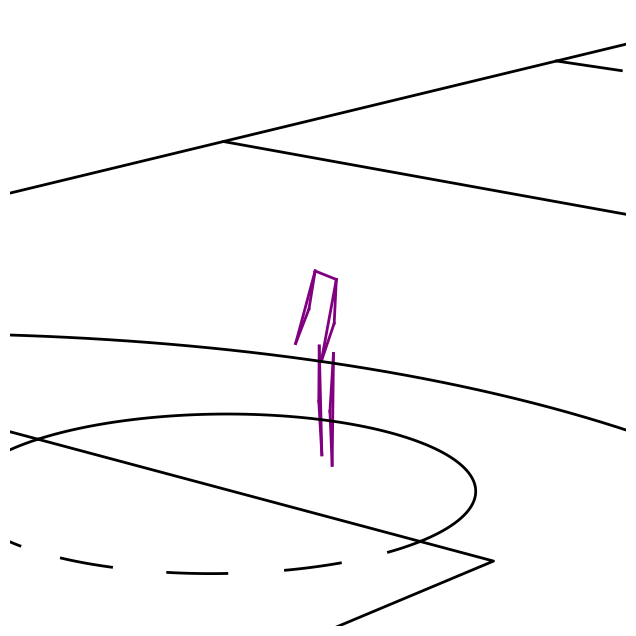

In [ ]:
# Example animation that demonstrates the features that the model will learn with
animate_trial("/content/drive/MyDrive/SPL-Open-Data/basketball/freethrow/data/P0001/BB_FT_P0001_T0001.json")

# Training the Model

In [18]:
from sklearn.model_selection import train_test_split

# Convert ground_truth and padded_sequences to numpy for easy indexing
ground_truth = np.array(ground_truth)
padded_sequences = np.array(padded_sequences)

# Separate indices for makes (1s) and misses (0s)
make_indices = np.where(ground_truth == 1)[0]
miss_indices = np.where(ground_truth == 0)[0]

# Select 30 makes and 30 misses for training
make_train, _ = train_test_split(make_indices, train_size=30, random_state=42)
miss_train, _ = train_test_split(miss_indices, train_size=30, random_state=42)

# Select 57 makes and 7 misses for validation
make_val, _ = train_test_split(make_indices, train_size=57, random_state=42)
miss_val, _ = train_test_split(miss_indices, train_size=7, random_state=42)

# Combine indices for balanced training and validation sets
train_indices = np.concatenate([make_train, miss_train])
val_indices = np.concatenate([make_val, miss_val])

# Extract sequences and labels for each set
X_train, y_train = padded_sequences[train_indices], ground_truth[train_indices]
X_val, y_val = padded_sequences[val_indices], ground_truth[val_indices]

# Convert to torch tensors
X_train, y_train = torch.tensor(X_train, dtype=torch.float32), torch.tensor(y_train, dtype=torch.float32)
X_val, y_val = torch.tensor(X_val, dtype=torch.float32), torch.tensor(y_val, dtype=torch.float32)

# Print distributions for confirmation
print("Train distribution:", np.bincount(y_train.int().numpy()))
print("Validation distribution:", np.bincount(y_val.int().numpy()))

Train distribution: [30 30]
Validation distribution: [ 7 57]


In [19]:
class RNN(nn.Module):
    def __init__(self, input_dim, hidden_dim, output_dim, num_layers=2, bidirectional=True):
        super(RNN, self).__init__()
        self.lstm = nn.LSTM(input_dim, hidden_dim, num_layers=num_layers,
                            batch_first=True, dropout=0.3, bidirectional=bidirectional)

        # Fully connected layer
        self.fc1 = nn.Linear(hidden_dim * 2 if bidirectional else hidden_dim, hidden_dim)
        self.fc2 = nn.Linear(hidden_dim, output_dim)

    def forward(self, x):
        # LSTM layer output
        _, (h_n, _) = self.lstm(x)

        # For bidirectional LSTM, concatenate final states from both directions
        if self.lstm.bidirectional:
            h_n = torch.cat((h_n[-2], h_n[-1]), dim=1)  # Concatenate last states from both directions
        else:
            h_n = h_n[-1]  # Take last state for unidirectional

        # Fully connected layers with ReLU activation
        out = F.relu(self.fc1(h_n))
        out = self.fc2(out)
        return out

In [20]:
train_dataset = TensorDataset(X_train, y_train)
val_dataset = TensorDataset(X_val, y_val)

batch_size = 16
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

input_dim = X_train.shape[2]
hidden_dim = 128
output_dim = 1

Epoch 1/200, Train Loss: 0.6950, Train Accuracy: 50.00%, Val Loss: 0.6746, Val Accuracy: 89.06%, TP: 57, FP: 7, TN: 0, FN: 0
Epoch 2/200, Train Loss: 0.6941, Train Accuracy: 50.00%, Val Loss: 0.6709, Val Accuracy: 89.06%, TP: 57, FP: 7, TN: 0, FN: 0
Epoch 3/200, Train Loss: 0.6946, Train Accuracy: 50.00%, Val Loss: 0.6728, Val Accuracy: 89.06%, TP: 57, FP: 7, TN: 0, FN: 0
Epoch 4/200, Train Loss: 0.6922, Train Accuracy: 50.00%, Val Loss: 0.6770, Val Accuracy: 89.06%, TP: 57, FP: 7, TN: 0, FN: 0
Epoch 5/200, Train Loss: 0.6940, Train Accuracy: 50.00%, Val Loss: 0.6776, Val Accuracy: 89.06%, TP: 57, FP: 7, TN: 0, FN: 0
Epoch 6/200, Train Loss: 0.6916, Train Accuracy: 50.00%, Val Loss: 0.6812, Val Accuracy: 89.06%, TP: 57, FP: 7, TN: 0, FN: 0
Epoch 7/200, Train Loss: 0.6921, Train Accuracy: 51.67%, Val Loss: 0.6835, Val Accuracy: 89.06%, TP: 57, FP: 7, TN: 0, FN: 0
Epoch 8/200, Train Loss: 0.6917, Train Accuracy: 51.67%, Val Loss: 0.6874, Val Accuracy: 75.00%, TP: 48, FP: 7, TN: 0, FN: 9


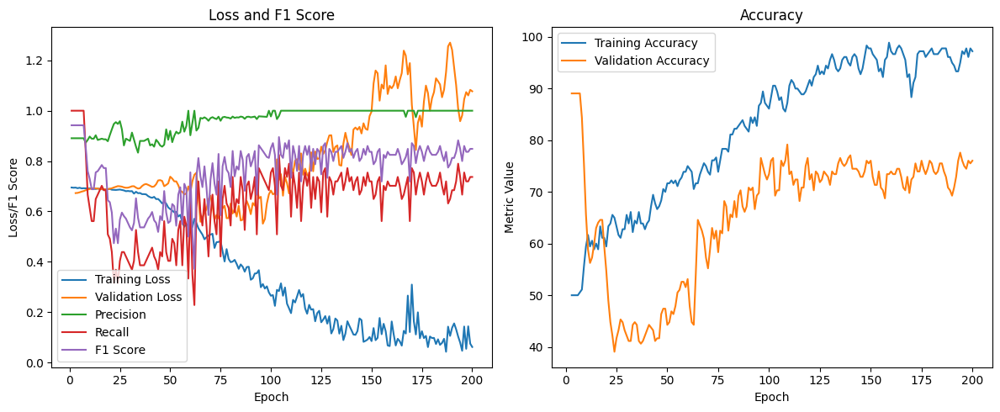

In [22]:
model = RNN(input_dim=input_dim, hidden_dim=hidden_dim, output_dim=output_dim, num_layers=2, bidirectional=True)

# Loss function and optimizer with a lower learning rate
criterion = nn.BCEWithLogitsLoss()  # More stable version for binary classification
optimizer = optim.Adam(model.parameters(), lr=0.0001)

# Initialize lists to store metrics
train_losses = []
train_accuracies = []
val_losses = []
val_accuracies = []
val_precision = []
val_recall = []
val_f1 = []

num_epochs = 200
print_every = 1

for epoch in range(num_epochs):
    model.train()
    total_loss = 0
    total_correct = 0
    total_samples = 0

    # Training
    for features, labels in train_loader:
        optimizer.zero_grad()
        outputs = model(features).squeeze()
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        # Calculate accuracy
        predictions = (torch.sigmoid(outputs) > 0.5).float()
        correct = (predictions == labels).sum().item()
        total_correct += correct
        total_samples += labels.size(0)
        total_loss += loss.item()

    train_accuracy = total_correct / total_samples * 100
    train_losses.append(total_loss / len(train_loader))
    train_accuracies.append(train_accuracy)

    # Validation
    model.eval()
    val_loss = 0
    val_correct = 0
    val_samples = 0
    tp = 0
    fp = 0
    tn = 0
    fn = 0

    with torch.no_grad():
        for val_features, val_labels in val_loader:
            val_outputs = model(val_features).squeeze()
            val_loss += criterion(val_outputs, val_labels).item()

            val_predictions = (torch.sigmoid(val_outputs) > 0.5).float()
            val_correct += (val_predictions == val_labels).sum().item()
            val_samples += val_labels.size(0)
            tp += ((val_predictions == 1) & (val_labels == 1)).sum().item()
            fp += ((val_predictions == 1) & (val_labels == 0)).sum().item()
            tn += ((val_predictions == 0) & (val_labels == 0)).sum().item()
            fn += ((val_predictions == 0) & (val_labels == 1)).sum().item()

    val_accuracy = val_correct / val_samples * 100
    val_losses.append(val_loss / len(val_loader))
    val_accuracies.append(val_accuracy)
    if(tp + fp != 0):
      val_precision.append(tp / (tp + fp))
    else:
      val_precision.append(0)
    if(tp + fn != 0):
      val_recall.append(tp / (tp + fn))
    else:
      val_recall.append(0)
    if(tp + fp == 0 or tp + fn == 0):
      val_f1.append(0)
    else:
      val_f1.append((2 * (tp/(tp + fn)) * (tp/(tp + fp)))/((tp/(tp + fn)) + (tp/(tp + fp))))

    # Print progress every few epochs
    if (epoch + 1) % print_every == 0:
        print(f"Epoch {epoch+1}/{num_epochs}, Train Loss: {train_losses[-1]:.4f}, Train Accuracy: {train_accuracies[-1]:.2f}%, "
              f"Val Loss: {val_losses[-1]:.4f}, Val Accuracy: {val_accuracies[-1]:.2f}%, TP: {tp}, FP: {fp}, TN: {tn}, FN: {fn}")
        model_path = "{0}_lr{1}_epoch#{2}".format(RNN, 0.0001, epoch)
        torch.save(model.state_dict(), model_path)

# Plot accuracy and loss
epochs = range(1, num_epochs + 1)
plt.figure(figsize=(12, 5))

window_size = 3  # Adjust this value to control smoothing

# Apply moving average smoothing to each metric
train_losses_smooth = pd.Series(train_losses).rolling(window=window_size).mean()
val_losses_smooth = pd.Series(val_losses).rolling(window=window_size).mean()
train_accuracies_smooth = pd.Series(train_accuracies).rolling(window=window_size).mean()
val_accuracies_smooth = pd.Series(val_accuracies).rolling(window=window_size).mean()

precisions_smooth = pd.Series(val_precision).rolling(window=window_size).mean()
recalls_smooth = pd.Series(val_recall).rolling(window=window_size).mean()
f1_scores_smooth = pd.Series(val_f1).rolling(window=window_size).mean()

# Plot Losses and F1 Scores
plt.subplot(1, 2, 1)
plt.plot(epochs, train_losses, label='Training Loss')
plt.plot(epochs, val_losses_smooth, label='Validation Loss')
plt.plot(epochs, val_precision, label='Precision')
plt.plot(epochs, val_recall, label='Recall')
plt.plot(epochs, val_f1, label='F1 Score')
plt.xlabel('Epoch')
plt.ylabel('Loss/F1 Score')
plt.title('Loss and F1 Score')
plt.legend()

# Plot Accuracies
plt.subplot(1, 2, 2)
plt.plot(epochs, train_accuracies_smooth, label='Training Accuracy')
plt.plot(epochs, val_accuracies_smooth, label='Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Metric Value')
plt.title('Accuracy')
plt.legend()

plt.tight_layout()
plt.show()

In [23]:
#Save an instance of the model
input_dim = X_train.shape[2]
hidden_dim = 128
output_dim = 1
net = RNN(input_dim=input_dim, hidden_dim=hidden_dim, output_dim=output_dim, num_layers=2, bidirectional=True)
model_path = "/content/<class '__main__.RNN'>_lr0.0001_epoch#177" #Change this depending on which epoch you want to save
state = torch.load(model_path)
net.load_state_dict(state)

<ipython-input-23-f3aab976ea09>:7: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state = torch.load(model_path)


<All keys matched successfully>

# Visualizing Model Performance

In [28]:
net.eval()
tp = 0
fp = 0
tn = 0
fn = 0
with torch.no_grad():
        for val_features, val_labels in val_loader:
            val_outputs = net(val_features).squeeze()
            val_predictions = (torch.sigmoid(val_outputs) > 0.5).float()
            tp += ((val_predictions == 1) & (val_labels == 1)).sum().item()
            fp += ((val_predictions == 1) & (val_labels == 0)).sum().item()
            tn += ((val_predictions == 0) & (val_labels == 0)).sum().item()
            fn += ((val_predictions == 0) & (val_labels == 1)).sum().item()

tensor([[[  1.4736,   1.4112,   2.6281,  ..., 158.7466, 159.4297,   1.1090],
         [  1.4623,   1.4153,   2.5879,  ..., 152.0453, 160.3994,   1.1100],
         [  1.4508,   1.4101,   2.5365,  ..., 144.6669, 161.9938,   1.1120],
         ...,
         [  0.0000,   0.0000,   0.0000,  ...,   0.0000,   0.0000,   0.0000],
         [  0.0000,   0.0000,   0.0000,  ...,   0.0000,   0.0000,   0.0000],
         [  0.0000,   0.0000,   0.0000,  ...,   0.0000,   0.0000,   0.0000]],

        [[  1.5576,   1.6091,   2.6932,  ..., 160.7385, 170.4874,   1.0900],
         [  1.5431,   1.5969,   2.7171,  ..., 163.1540, 170.5641,   1.1090],
         [  1.5280,   1.5742,   2.7338,  ..., 164.6136, 170.4948,   1.1240],
         ...,
         [  0.0000,   0.0000,   0.0000,  ...,   0.0000,   0.0000,   0.0000],
         [  0.0000,   0.0000,   0.0000,  ...,   0.0000,   0.0000,   0.0000],
         [  0.0000,   0.0000,   0.0000,  ...,   0.0000,   0.0000,   0.0000]],

        [[  1.2306,   1.2767,   2.6628,  ...

In [25]:
actual = []
predicted = []
for i in range(tp):
  actual.append(1)
  predicted.append(1)
for i in range(fp):
  actual.append(0)
  predicted.append(1)
for i in range(tn):
  actual.append(0)
  predicted.append(0)
for i in range(fn):
  actual.append(1)
  predicted.append(0)


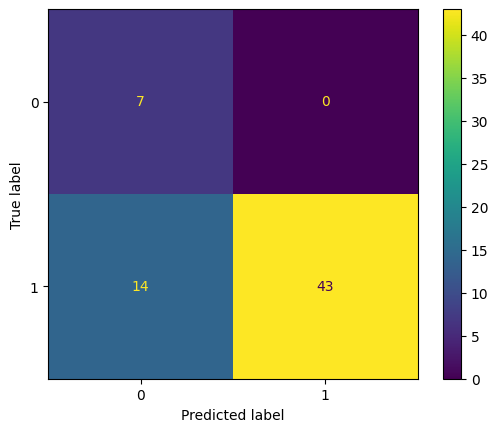

In [26]:
from sklearn import metrics
confusion_matrix = metrics.confusion_matrix(actual, predicted)
cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = confusion_matrix, display_labels = [0, 1])
cm_display.plot()
plt.show()

This result highlights the model's capability to detect biomechanical patterns associated with poor form, even when a free throw is successful. False negatives, in this case, represent made free throws with biomechanical features commonly seen in missed attempts, suggesting potential areas for form improvement.

In [44]:
tp_jsons = []
fp_jsons = []
fn_jsons = []
tn_jsons = []

with torch.no_grad():
  for val_features, val_labels in val_loader:
    for feature, label in zip(val_features, val_labels):
      for i in range(len(all_sequences)):
        if torch.equal(feature, torch.tensor(padded_sequences[i])):
                  print(f"Feature matches padded_sequence[{i}]")
                  feature = feature.unsqueeze(1)
                  feature = feature.permute(1, 0, 2)
                  output = net(feature).squeeze()
                  prediction = (torch.sigmoid(output) > 0.5).float()
                  trial_id = f"{(i + 1):04}"
                  if prediction.item() == 1 and label.item() == 1:
                    tp_jsons.append(f"/content/drive/MyDrive/SPL-Open-Data/basketball/freethrow/data/P0001/BB_FT_P0001_T{trial_id}.json")
                  elif prediction.item() == 1 and label.item() == 0 :
                    fp_jsons.append(f"/content/drive/MyDrive/SPL-Open-Data/basketball/freethrow/data/P0001/BB_FT_P0001_T{trial_id}.json")
                  elif prediction.item() == 0 and label.item() == 1:
                    fn_jsons.append(f"/content/drive/MyDrive/SPL-Open-Data/basketball/freethrow/data/P0001/BB_FT_P0001_T{trial_id}.json")
                  else:
                    tn_jsons.append(f"/content/drive/MyDrive/SPL-Open-Data/basketball/freethrow/data/P0001/BB_FT_P0001_T{trial_id}.json")



Feature matches padded_sequence[64]
Feature matches padded_sequence[30]
Feature matches padded_sequence[62]
Feature matches padded_sequence[50]
Feature matches padded_sequence[19]
Feature matches padded_sequence[71]
Feature matches padded_sequence[87]
Feature matches padded_sequence[33]
Feature matches padded_sequence[103]
Feature matches padded_sequence[40]
Feature matches padded_sequence[67]
Feature matches padded_sequence[26]
Feature matches padded_sequence[38]
Feature matches padded_sequence[7]
Feature matches padded_sequence[31]
Feature matches padded_sequence[56]
Feature matches padded_sequence[20]
Feature matches padded_sequence[99]
Feature matches padded_sequence[18]
Feature matches padded_sequence[81]
Feature matches padded_sequence[53]
Feature matches padded_sequence[110]
Feature matches padded_sequence[124]
Feature matches padded_sequence[77]
Feature matches padded_sequence[63]
Feature matches padded_sequence[72]
Feature matches padded_sequence[66]
Feature matches padded_seq

In [68]:
def animate_trial_gif(
    path_to_json,
    connections=connections,
    xbuffer=4.0,
    ybuffer=4.0,
    zlim=8.0,
    elev=15.0,
    azim=40.0,
    player_color="purple",
    player_lw=2,
    ball_color="#ee6730",
    ball_size=20.0,
    show_court=True,
    notebook_mode=True,
):
    """
    Function to animate a single trial of 3D pose data.

    Parameters:
    -----------
    - path_to_json: str
        The path to the JSON file containing the 3D pose data.
    - connections: list of tuples
        A list of tuples, where each tuple contains two strings representing the joints to connect.
    - xbuffer: float
        The buffer to add to the x-axis limits.
    - ybuffer: float
        The buffer to add to the y-axis limits.
    - zlim: float
        The limit for the z-axis height.
    - elev: float
        The elevation angle for the 3D plot.
    - azim: float
        The azimuth angle for the 3D plot.
    - player_color: str
        The color to use for the player lines.
    - player_lw: float
        The line width to use for the player lines.
    - ball_color: str
        The color to use for the ball.
    - ball_size: float
        The size to use for the ball.
    - show_court: bool
        Whether to show the basketball court in the background.
    - notebook_mode: bool
        Whether function is used within a Jupyter notebook.

    Returns:
    --------
    - anim: matplotlib.animation.FuncAnimation
        The animation object created by the function.
    """

    if notebook_mode:
        plt.rcParams["animation.html"] = "jshtml"

    if show_court:
        try:
            from mplbasketball.court3d import draw_court_3d
        except ModuleNotFoundError:
            print("mplbasketball not installed. Cannot show court.")
            show_court = False

    with open(path_to_json, "r") as f:
        data = json.load(f)

    player_joint_dict = {}
    ball_data_array = []

    N_frames = len(data["tracking"])

    # The block of code below returns a dictionary, where each key is a 3D time series for coordinates of a joint.
    # Note that it is a list of N_frames elements, each of which is a 3-element list.
    # If you want to use numpy, you will have to cast it into a numpy array.
    for frame_data in data["tracking"]:
        for joint in frame_data["data"]["player"]:
            if joint not in player_joint_dict:
                player_joint_dict[joint] = []
            player_joint_dict[joint].append(frame_data["data"]["player"][joint])
        ball_data_array.append(frame_data["data"]["ball"])

    # For convenience, we will cast everything to numpy arrays here, but you can keep them as lists if you prefer.
    for joint in player_joint_dict:
        player_joint_dict[joint] = np.array(player_joint_dict[joint])
    ball_data_array = np.array(ball_data_array)

    # Animate the data
    fig = plt.figure(figsize=(8, 8))
    ax = fig.add_subplot(111, projection="3d")
    # Set up initial plot properties
    ax.set_zlim([0, zlim])
    ax.set_box_aspect([1, 1, 1])
    ax.xaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
    ax.yaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_zticks([])
    ax.view_init(elev=elev, azim=azim)

    # Prepare the lines to be updated
    lines = {
        connection: ax.plot([], [], [], c=player_color, lw=player_lw)[0]
        for connection in connections
    }

    (ball,) = ax.plot([], [], [], "o", markersize=ball_size, c=ball_color)

    def update(frame):

        # Use the average of the right and left hip to center the view.
        rh_xy = player_joint_dict["R_HIP"][frame][:2]
        lh_xy = player_joint_dict["L_HIP"][frame][:2]
        mh_xy = (rh_xy + lh_xy) / 2

        ax.set_xlim([mh_xy[0] - xbuffer, mh_xy[0] + xbuffer])
        ax.set_ylim([mh_xy[1] - ybuffer, mh_xy[1] + ybuffer])

        # Update the line data for each connection
        for connection in connections:
            part1, part2 = connection
            x = [
                player_joint_dict[part1][frame, 0],
                player_joint_dict[part2][frame, 0],
            ]
            y = [
                player_joint_dict[part1][frame, 1],
                player_joint_dict[part2][frame, 1],
            ]
            z = [
                player_joint_dict[part1][frame, 2],
                player_joint_dict[part2][frame, 2],
            ]
            lines[connection].set_data_3d(x, y, z)

        # Update ball data
        x = ball_data_array[frame, 0]
        y = ball_data_array[frame, 1]
        z = ball_data_array[frame, 2]
        ball.set_data_3d([x], [y], [z])

    if show_court is True:
        ax.grid(False)
        ax.xaxis.pane.fill = False
        ax.yaxis.pane.fill = False
        ax.zaxis.pane.fill = False
        ax.xaxis.pane.set_edgecolor("w")
        ax.yaxis.pane.set_edgecolor("w")
        ax.zaxis.pane.set_edgecolor("w")
        ax.xaxis.line.set_linewidth(0)
        ax.yaxis.line.set_linewidth(0)
        ax.zaxis.line.set_linewidth(0)
        draw_court_3d(ax, origin=np.array([0.0, 0.0]), line_width=2)

    # plt.tight_layout()
    plt.subplots(layout="constrained")
    plt.close()

    # Create the animation
    anim = FuncAnimation(fig, update, frames=N_frames, interval=1000 / 30)

    # Save the animation as a GIF
    anim.save("animation.gif", writer="pillow", fps=30)

    # Return the animation object (optional, for interactive use in notebooks)
    return anim

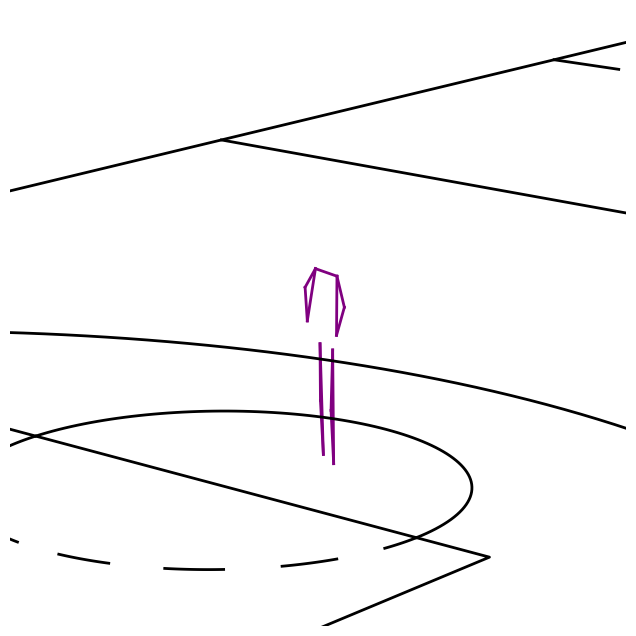

In [77]:
animate_trial_gif(tp_jsons[2]) # Change the function argument to see different shots from tp, fp, fn, and tn json lists